# Exploratory Data Analysis of Airbnb Accommodation in Copenhagen
> "An Exam Project in Business Data Processing and Business Intelligence"

- toc:true
- branch: master
- badges: true
- comments: true
- author: "119183"
- categories: [Exploratory Data Analysis, Data Visualization, WordCloud, Airbnb, Neighbourhoods in Copenhagen, Accommodation Pricing]

> Note: Code sections can be made visible by using the provided buttons throughout this project

##!¤%& 1.0 ABSTRACT 

Topic

Problem formulation

Research question

Concepts

Dataset and main data analytics methods and tools

Most important results

Conclusions and recommendations


##2.0 INTRODUCTION
Since 2008, Airbnb has grown from a small accommodation platform, hosted in San Francisco, to one that is now recognised throughout the world. Airbnb has revolutionized the tourism housing industry by applying a sharing economy model to the accommodation business. Today, Airbnb has become the world’s largest accommodation service provider with more accommodation options than any other accommodation business - and even more than all of them combined. As a platform, Airbnb enables people (hosts) to offer accommodation services to other people (guests), providing guests with a more unique and personalized way of experiencing the world, and often at a reasonably lower price than other accommodation options. Only just a fraction (20%) of these transactions are captured by Airbnb, which in 2019 returned 4,7 billion USD in sales revenues.

###2.1 PROBLEM FORMULATION AND RESEARCH QUESTION
Data plays a key role in Airbnb’s success. For instance, data enables Airbnb to match guests and hosts and further allows the users to filter the host listings to their likings, in respect of pricing, location, number of beds, and much more. Thereby, data is essential to securing high customer satisfaction. Moreover, Airbnb can use the collected data to extract insights that can be used to improve their service offerings, guide decision making, guide marketing initiatives, and more.

As a platform, Airbnb’s sole value creation lies in creating successful matches between guests and hosts and by ensuring a positive experience for both parties. Naturally, if the platform fails to deliver a positive experience to a user, the user might neglect the platform in total, resulting in negative feedback loops.
This leads us to our research question:

**How can Airbnb ensure matches and the experiences they create are positive for their customers (users), and providers (hosts)? Moreover, how can Airbnb help guide user decisions to create successful matches and positive experiences?**

Currently, Airbnb helps the users to create meaningful matches, by allowing the guests to limit their search for accommodation by different attributes related to the individual host listing. As such, users can easily find accommodation that meets their basic needs for accommodation; e.g. number of beds, bedrooms, price, room type, etc. However, without any knowledge of the different location areas, guests might find difficulty in choosing a location that suits their needs.

In this project, we will examine the accommodation services, listed on Airbnb for Copenhagen, in special regard to the location areas, and the attributes that are associated with them. The goal is to create a report that can guide customers to choose a location that lives up to their expectations, thereby improving the quality of the matches provided by the platform.

##3.0 METHODOLOGY

###3.1 DATASET DESCRIPTION
The data was downloaded from the independent site: [Inside Airbnb](http://insideairbnb.com/get-the-data.html), which scrapes data from Airbnb, and makes it puplicly available for analysis. This site provides a multitude of datasets containing information on the most populated cities around the world - including Copenhagen.

The datasets provided by Inside Airbnb is as follows: (1) listings, (2) calendar, (3) reviews, (4) listings_summary, (5) reviews_summary.

We have downloaded and inspected all of the datasets, however the calendar dataset is assessed to be unimportant. Thus, the listings and reviews data has been chosen to conduct this project. Furthermore, we chose the most recently scraped data: *28th of Nov. 2020.*



####3.1.1 LISTINGS.CSV.GZ
The listings dataset contains data about the airbnb host listings and their respective attributes. In total, there are 74 columns describing 8636 listings on the Airbnb platform.

Here, we provide you with a short glimpse of some of the attributes in the listings dataset:
- id: primary key (listings_id)
- name: name of the listing
- neightbourhood_cleansed: location area
- latitude: latitude
- longitude: longitude
- beds: number of beds in the room
- bedrooms: number of bedrooms in the room
- price: price of the room per day
- room_type: type of room that is made available
- property_type: type of the property where the room is in
- review_score: average review score of the listing


####3.1.2 REVIEWS.CSV.GZ
The reviews dataset contains data about reviews that were given for the listed accommodation services. In total, there are 6 columns describing 185.564 reviews.

Here, we provide you with a short glimpse of some of the attributes in the reviews dataset:

- listing_id: foreign key references listings
- id:  primary key (review_id)
- date: date review was written
- reviewer_name: name of reviewer
- comments: review text

###3.2 Dataset Analysis Process

For this project we perform an exploratory data analysis of the data, as well as visualize the processed data in an interactive map, and furthermore display wordclouds of the review text.

Before we can start the analysis we install the necessary libraries for our python interpreter to work with the data. Specifically, we will be using pandas to create and manage the data in pandas dataframe. We use Plotly's Express library to visualize the data in an interactive map. Furthermore, we use WordCloud and Matplotlib's Pyplot to visualize wordsclouds of the review texts. 

Once the necessary packages are installed and imported, we can begin to gather the data and initiate the data cleaning process. We use pandas to download the data from Inside Airbnb and to uncompress it, using the in-built decompressor.

We then give a quick glimpse of the datasets that we gathered, before beginning the data cleaning. To clean the data, start by removing columns that are empty, listings that has never been reviewed, renaming columns to be easier interpretable, and finally correcting the data types.

We should now have clean data, that we can use to analyze the attributes of the listings. Here, we will investigate the distributions of prices, neighbourhoods, property types, and room types. Similarly, we will investigate the average prices of listings by neighbourhood, property type, and by room type. In conclusion, we aim to list differnces that occour for each different category.

Nearing the end, the two datasets are merged into one dataframe, that contains data about both listings and reviews. These are joined by the listings_id using the 'inner' property. We can then use this dataframe to display the interactive map, and wordclouds that summarized the reviews of each neighbourhood.

Now, let's get started!

##Install Libraries

In [ ]:
#collapse-hide
import pandas as pd
import requests
import matplotlib.pyplot as plt
import plotly.express as px
import numpy as np

from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

##Gathering the Data

In [ ]:
#collapse-hide
#Create DataFrames
listings = pd.read_csv('http://data.insideairbnb.com/denmark/hovedstaden/copenhagen/2020-11-28/data/listings.csv.gz', compression='gzip')
reviews = pd.read_csv('http://data.insideairbnb.com/denmark/hovedstaden/copenhagen/2020-11-28/data/reviews.csv.gz', compression='gzip')

###Quick Glimpse of the Data

####Listings

In [ ]:
#collapse-hide
listings.head()

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,6983,https://www.airbnb.com/rooms/6983,20201128003729,2020-11-28,Copenhagen 'N Livin',Lovely apartment located in the hip Nørrebro a...,"Nice bars and cozy cafes just minutes away, ye...",https://a0.muscache.com/pictures/42044170/f63c...,16774,https://www.airbnb.com/users/show/16774,Simon,2009-05-12,"Copenhagen, Capital Region of Denmark, Denmark",I'm currently working as an environmental cons...,NaN,NaN,0%,f,https://a0.muscache.com/im/users/16774/profile...,https://a0.muscache.com/im/users/16774/profile...,Nørrebro,1.0,1.0,"['email', 'phone', 'reviews']",t,f,"Copenhagen, Hovedstaden, Denmark",Nrrebro,NaN,55.68798,12.54571,Private room in apartment,Private room,2,NaN,1 shared bath,1.0,1.0,"[""Hot water"", ""Refrigerator"", ""Heating"", ""Stov...",$361.00,2,15,2,2,15,15,2.0,15.0,NaN,t,29,59,89,89,2020-11-28,168,0,0,2009-09-04,2019-07-19,96.0,10.0,9.0,10.0,10.0,9.0,9.0,NaN,f,1,0,1,0,1.23
1,26057,https://www.airbnb.com/rooms/26057,20201128003729,2020-11-29,Lovely house - most attractive area,Our lovely house in the center of the city is ...,The neighborhood is the most famous one and th...,https://a0.muscache.com/pictures/bfbca07e-4cc1...,109777,https://www.airbnb.com/users/show/109777,Kari,2010-04-17,"Copenhagen, Capital Region of Denmark, Denmark","We are a family with 2 children, and living in...",within a few hours,100%,0%,f,https://a0.muscache.com/im/users/109777/profil...,https://a0.muscache.com/im/users/109777/profil...,Indre By,1.0,1.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",t,t,"Copenhagen, Hovedstaden, Denmark",Indre By,NaN,55.69163,12.57459,Entire house,Entire home/apt,6,NaN,1.5 baths,4.0,4.0,"[""Kitchen"", ""Essentials"", ""Cooking basics"", ""I...","$2,400.00",3,30,3,3,30,30,3.0,30.0,NaN,t,11,30,60,335,2020-11-29,50,1,0,2013-12-02,2019-12-14,98.0,10.0,10.0,10.0,10.0,10.0,10.0,NaN,f,1,1,0,0,0.59
2,29118,https://www.airbnb.com/rooms/29118,20201128003729,2020-11-28,Best Location in Cool Istedgade,<b>The space</b><br />The apartment is situate...,NaN,https://a0.muscache.com/pictures/236213/33956c...,125230,https://www.airbnb.com/users/show/125230,Nana,2010-05-15,"Copenhagen, Capital Region of Denmark, Denmark",I have a Master of Arts in Musicology and I wo...,NaN,NaN,25%,f,https://a0.muscache.com/im/users/125230/profil...,https://a0.muscache.com/im/users/125230/profil...,Vesterbro,1.0,1.0,"['email', 'phone', 'reviews', 'offline_governm...",t,t,NaN,Vesterbro-Kongens Enghave,NaN,55.67069,12.55430,Entire apartment,Entire home/apt,2,NaN,1 bath,1.0,1.0,"[""Hot water"", ""Changing table"", ""Refrigerator""...",$725.00,7,14,3,5,14,14,4.1,14.0,NaN,t,0,23,53,143,2020-11-28,22,0,0,2010-06-17,2019-08-02,98.0,10.0,10.0,10.0,10

In [ ]:
#collapse-hide
listings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8636 entries, 0 to 8635
Data columns (total 74 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            8636 non-null   int64  
 1   listing_url                                   8636 non-null   object 
 2   scrape_id                                     8636 non-null   int64  
 3   last_scraped                                  8636 non-null   object 
 4   name                                          8635 non-null   object 
 5   description                                   8396 non-null   object 
 6   neighborhood_overview                         4936 non-null   object 
 7   picture_url                                   8636 non-null   object 
 8   host_id                                       8636 non-null   int64  
 9   host_url                                      8636 non-null   o

In [ ]:
#collapse-hide
listings.shape

(8636, 74)

####Reviews

In [ ]:
#collapse-hide
reviews.head(20)

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,6983,8985,2009-09-04,31133,Jeff,"Convenient location, clean apartment, great br..."
1,6983,9199,2009-09-07,11472,Andrea,We really enjoyed staying to Simon in our firs...
2,6983,11763,2009-09-28,35317,Jeanine,"Friendly host, save neighbourhood, clean appar..."
3,6983,20616,2009-12-17,53151,Sonja,"Simon is great! Fantastic place to stay, supe..."
4,6983,23168,2010-01-04,50856,James,"Great bed, clean apartment, comfy bed, accomod..."
5,6983,33706,2010-04-05,96881,Tom,"Great value, very clean and comfortable apartm..."
6,6983,40860,2010-05-08,113545,Orion,"Amazingly helpful and friendly, close to town,..."
7,6983,51622,2010-06-10,135677,Gonzalo,"Thoroughly recommended, Simon is a great host ..."
8,6983,54476,2010-06-18,138676,Tiffany,"Fantastic host! Simon was friendly, outgoing a..."
9,6983,56504,2010-06-23,141069,Payton,Great location in an interesting neighborhood ...


In [ ]:
#collapse-hide
reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185564 entries, 0 to 185563
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   listing_id     185564 non-null  int64 
 1   id             185564 non-null  int64 
 2   date           185564 non-null  object
 3   reviewer_id    185564 non-null  int64 
 4   reviewer_name  185564 non-null  object
 5   comments       185464 non-null  object
dtypes: int64(3), object(3)
memory usage: 8.5+ MB


In [ ]:
#collapse-hide
reviews.shape

(185564, 6)

##Preprocessing

###Cleaning Listing Data

In [ ]:
#collapse-hide

#Removing empty columns
listings.drop(columns=['neighbourhood_group_cleansed','bathrooms','calendar_updated','license'], inplace=True)

#Deselect Listings with no reviews
listings = listings[listings.number_of_reviews > 0]

#Rename columns
listings.rename(columns={'id':'listing_id','name':'listing_name','description':'listing_description'},inplace=True)

#Correct DataTypes
listings = listings.astype(
    {
     #DateTime:
     'last_scraped':'datetime64[ns]',
     'host_since':'datetime64[ns]',
     'calendar_last_scraped':'datetime64[ns]',
     'first_review':'datetime64[ns]',
     'last_review':'datetime64[ns]'
     }
    )

#Correct Prices from $ to DKK, then DataType
listings.price = listings.price.str.replace(',','')
listings.price = listings.price.str.replace('$','')
listings.price = listings.price.astype(float)

###Cleaning Reviews Data 

In [ ]:
#collapse-hide

#Rename Columns
reviews.rename(columns={'id':'reivew_id','date':'review_date','comments':'review_text'},inplace=True)

#Change DataTypes
reviews.review_date = pd.to_datetime(reviews.review_date)

##EDA

###Distributions

####Neighbourhoods

In [ ]:
#collapse-hide
neighbourhoods = listings['neighbourhood_cleansed'].value_counts().to_frame(name='listings').reset_index()
neighbourhoods

,index,listings
0,Indre By,1426
1,Vesterbro-Kongens Enghave,1169
2,Nrrebro,1119
3,Frederiksberg,817
4,sterbro,777
5,Amager Vest,640
6,Amager st,546
7,Valby,267
8,Bispebjerg,261
9,Vanlse,181


####Property Types



In [ ]:
#collapse-hide
listings[['property_type']].value_counts().to_frame(name='listings').reset_index()

,property_type,listings
0,Entire apartment,4905
1,Private room in apartment,916
2,Entire condominium,412
3,Entire house,338
4,Entire townhouse,155
5,Entire serviced apartment,153
6,Private room in house,89
7,Entire loft,88
8,Private room in condominium,54
9,Private room in townhouse,39


####Room Types

In [ ]:
#collapse-hide
listings[['room_type']].value_counts().to_frame(name='listings').reset_index()

,room_type,listings
0,Entire home/apt,6131
1,Private room,1169
2,Hotel room,25
3,Shared room,12


####Property Types by Neighbourhood

In [ ]:
#collapse-hide

#Select properties listed more than 400 times
listings_clean = listings[listings.property_type.isin(['Entire apartment','Private room in apartment','Entire condominium','Entire house'])]

#Count number of listings in neighbourhoods by property type   
listings_byNeighbourhood = listings_clean.groupby(['neighbourhood_cleansed','property_type']).neighbourhood_cleansed.count().to_frame(name = 'listings').reset_index()

#Sum number of listings per neighbourhood
listingsNeighbourhoodCount = listings_byNeighbourhood.groupby('neighbourhood_cleansed')['listings'].sum().to_frame(name = 'total_listings').sort_values(by='total_listings', ascending=False).reset_index()

#Calculate ratio of property types in the different neighbourhoods
neighbourhoodPropertyRatio = listings_byNeighbourhood.merge(listingsNeighbourhoodCount, on='neighbourhood_cleansed')
neighbourhoodPropertyRatio['ratio_of_property_type_in_neighbourhood'] = neighbourhoodPropertyRatio['listings']/neighbourhoodPropertyRatio['total_listings']*100
neighbourhoodPropertyRatio.head(10)

,neighbourhood_cleansed,property_type,listings,total_listings,ratio_of_property_type_in_neighbourhood
0,Amager Vest,Entire apartment,373,551,67.695100
1,Amager Vest,Entire condominium,37,551,6.715064
2,Amager Vest,Entire house,62,551,11.252269
3,Amager Vest,Private room in apartment,79,551,14.337568
4,Amager st,Entire apartment,301,466,64.592275
5,Amager st,Entire condominium,36,466,7.725322
6,Amager st,Entire house,59,466,12.660944
7,Amager st,Private room in apartment,70,466,15.021459
8,Bispebjerg,Entire apartment,168,246,68.292683
9,Bispebjerg,Entire condominium,18,246,7.317073


####Room Types by Neighbourhood

In [ ]:
#collapse-hide

#Count number of listings in neighbourhoods by property type   
roomCount = listings.groupby(['neighbourhood_cleansed','room_type']).neighbourhood_cleansed.count().to_frame(name = 'listings').reset_index()

#Sum number of listings per neighbourhood
roomNeighbourhoodCount = roomCount.groupby('neighbourhood_cleansed')['listings'].sum().to_frame(name = 'total_listings').sort_values(by='total_listings', ascending=False).reset_index()

#Calculate ratio of property types in the different neighbourhoods
roomRatio = roomCount.merge(listingsNeighbourhoodCount, on='neighbourhood_cleansed')
roomRatio['ratio_of_room_type_in_neighbourhood'] = roomRatio['listings']/roomRatio['total_listings']*100
roomRatio.head(10)

,neighbourhood_cleansed,room_type,listings,total_listings,ratio_of_room_type_in_neighbourhood
0,Amager Vest,Entire home/apt,529,551,96.007260
1,Amager Vest,Hotel room,1,551,0.181488
2,Amager Vest,Private room,108,551,19.600726
3,Amager Vest,Shared room,2,551,0.362976
4,Amager st,Entire home/apt,434,466,93.133047
5,Amager st,Hotel room,3,466,0.643777
6,Amager st,Private room,108,466,23.175966
7,Amager st,Shared room,1,466,0.214592
8,Bispebjerg,Entire home/apt,206,246,83.739837
9,Bispebjerg,Private room,55,246,22.357724


####Accomodations by Neighbourhood

In [ ]:
#collapse-hide
df = pd.DataFrame()
df['avg_n_accommodations'] =listings.groupby('neighbourhood_cleansed').accommodates.mean()
df = df.reset_index()
df

,neighbourhood_cleansed,avg_n_accommodations
0,Amager Vest,3.668750
1,Amager st,3.483516
2,Bispebjerg,3.249042
3,Brnshj-Husum,4.589552
4,Frederiksberg,3.470012
5,Indre By,3.816971
6,Nrrebro,3.102770
7,Valby,3.550562
8,Vanlse,3.872928
9,Vesterbro-Kongens Enghave,3.230967


####Pricing by Neighbourhood

In [ ]:
#collapse-hide
neighbourhoodPricing = listings.groupby('neighbourhood_cleansed').price.mean().to_frame().sort_values(by='price', ascending=False).reset_index()
neighbourhoodPricing

,neighbourhood_cleansed,price
0,Indre By,1532.850631
1,sterbro,1039.018018
2,Amager st,1020.058608
3,Vesterbro-Kongens Enghave,1017.957228
4,Frederiksberg,1002.586291
5,Amager Vest,956.114063
6,Nrrebro,874.478999
7,Brnshj-Husum,809.671642
8,Valby,753.269663
9,Vanlse,752.756906


In [ ]:
#collapse-hide

#Calculate Average Price Per Person
df['price'] = neighbourhoodPricing.price
df['price_perPerson'] = df.price/df.avg_n_accommodations
df

,neighbourhood_cleansed,avg_n_accommodations,price,price_ratio,price_perPerson
0,Amager Vest,3.668750,1532.850631,417.812779,417.812779
1,Amager st,3.483516,1039.018018,298.267002,298.267002
2,Bispebjerg,3.249042,1020.058608,313.956718,313.956718
3,Brnshj-Husum,4.589552,1017.957228,221.798811,221.798811
4,Frederiksberg,3.470012,1002.586291,288.928748,288.928748
5,Indre By,3.816971,956.114063,250.490291,250.490291
6,Nrrebro,3.102770,874.478999,281.838134,281.838134
7,Valby,3.550562,809.671642,228.040431,228.040431
8,Vanlse,3.872928,753.269663,194.496161,194.496161
9,Vesterbro-Kongens Enghave,3.230967,752.756906,232.981949,232.981949


####Pricing by Property Type

In [ ]:
#collapse-hide
PropertyPricing = listings.groupby('property_type').price.mean().to_frame().sort_values(by='price', ascending=False).reset_index()
PropertyPricing.head(20)

,property_type,price
0,Boat,1839.714286
1,Entire villa,1800.774194
2,Houseboat,1636.083333
3,Island,1600.000000
4,Private room,1500.000000
5,Entire loft,1488.738636
6,Entire townhouse,1476.600000
7,Entire serviced apartment,1459.496732
8,Entire house,1371.062130
9,Room in serviced apartment,1235.400000


####Pricing by Room Type

In [ ]:
#collapse-hide
roomPricing = listings.groupby('room_type').price.mean().to_frame().sort_values(by='price', ascending=False).reset_index()
roomPricing.head(20)

,room_type,price
0,Entire home/apt,1151.074539
1,Hotel room,960.080000
2,Shared room,618.583333
3,Private room,584.256630


#Visualizations


##Maps

In [ ]:
#collapse-hide

#Merge reviews and listings
group_listingReviews = reviews.merge(listings, on='listing_id', how='inner')

#Define mapbox API token and style
mapbox_access_token = 'pk.eyJ1IjoiYWNodG9uMjExMSIsImEiOiJja2lyam5yemgyNTV0MnJsYmJ0NXdzNWRxIn0.rWJgur27hJnWoBt7Oq5LeQ'
px.set_mapbox_access_token(mapbox_access_token)
plot_style = 'mapbox://styles/achton2111/ckirsv5df0aj01at4zp0d7f3w'

#Interactive Geospacial plot
fig = px.scatter_mapbox(group_listingReviews,
                        lat="latitude",
                        lon="longitude",
                        color="neighbourhood_cleansed",
                        zoom=10,
                        size='price',
                        mapbox_style= plot_style,
                        hover_name='listing_name',
                        hover_data = {'price',
                                      'property_type',
                                      'room_type',
                                      'accommodates',
                                      'beds',
                                      'review_scores_rating'},
                        opacity = 0.8,
                        title = 'AirBnB Listing Locations. Coloured by Neighbourhood, Size by Price)'
                        )
fig.show()

##WordClouds

Let's try to see if there are any visual differences between reviews in the different neighbourhoods

In [ ]:
#collapse-hide

#Distinction between neighbourhoods
norrebro = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'Nrrebro']
indreby = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'Indre By']
vesterbro_KgsEnghave = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'Vesterbro-Kongens Enghave']
osterbro = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'sterbro']
frederiksberg = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'Frederiksberg']
amagerOst = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'Amager st']
amagerVest = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'Amager Vest']
valby = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'Valby']
bispebjerg = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'Bispebjerg']
vanlose = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'Vanlse']
bronshojHusum = group_listingReviews[group_listingReviews.neighbourhood_cleansed == 'Brnshj-Husum']

####Norrebro

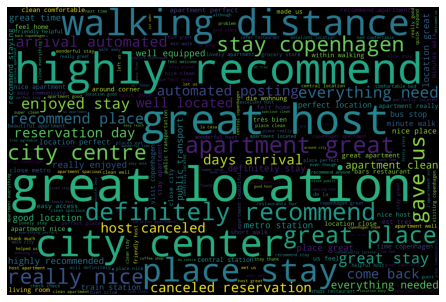

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in norrebro.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

####Indre By

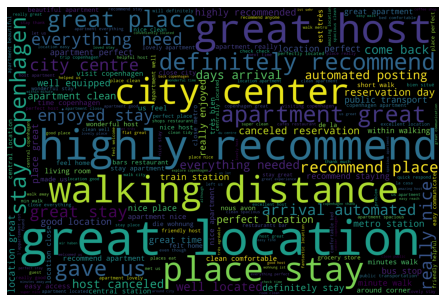

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in indreby.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

####Vesterbro - Kongens Enghave

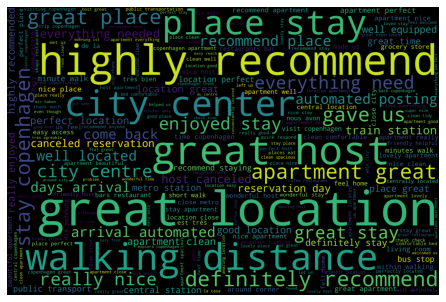

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in vesterbro_KgsEnghave.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

####Østerbro

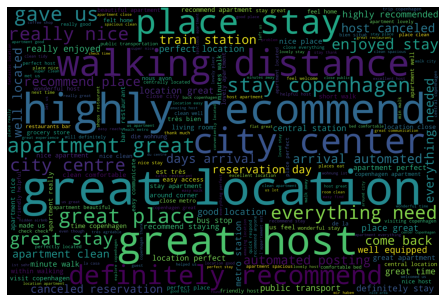

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in osterbro.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

####Frederiksberg

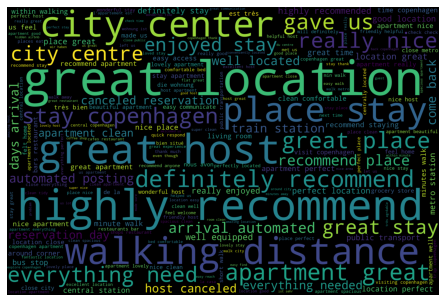

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in frederiksberg.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

####Amager Øst

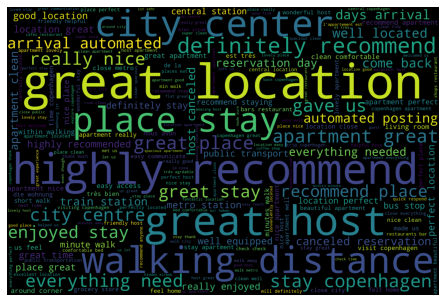

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in amagerOst.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

####Amager Vest

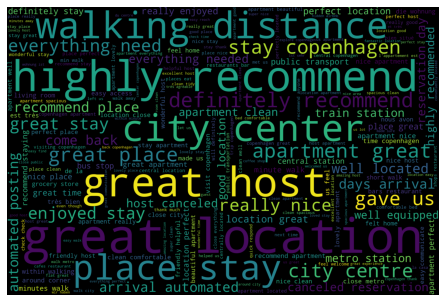

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in amagerVest.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

####Valby

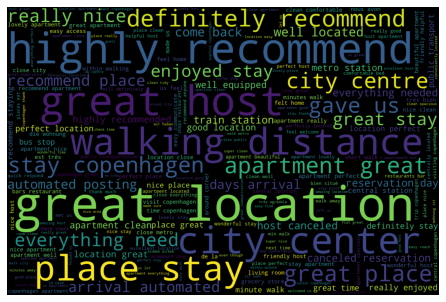

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in valby.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

####Bispebjerg

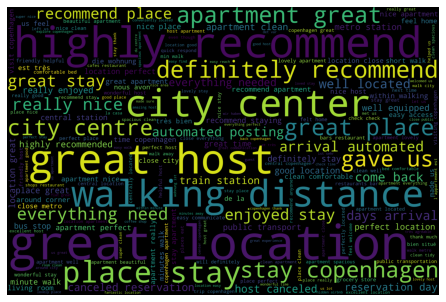

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in bispebjerg.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

####Vanløse

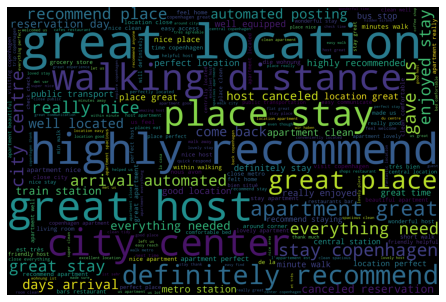

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in vanlose.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

####Brønshøj - Husum

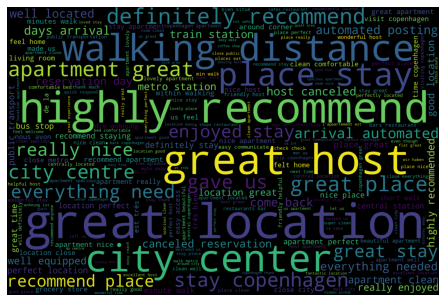

In [ ]:
#collapse-hide

# Iterating through the .csv data file 
for i in bronshojHusum.review_text: 
    i = str(i) 
    separate = i.split() 
    for j in range(len(separate)): 
        separate[j] = separate[j].lower() 
    comment_words += " ".join(separate)+" "

# Creating the Word Cloud
final_wordcloud = WordCloud(width = 3000, height = 2000, 
                background_color ='black', 
                stopwords = STOPWORDS, 
                min_font_size = 10).generate(comment_words)

# Displaying the WordCloud                    
plt.figure(facecolor = None) 
plt.imshow(final_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

##4.0 RESULTS

##5.0 DISCUSSION

##6.0 CONCLUSION